### Data Augmentation, 데이터 증강
- 이미지의 종류와 개수가 적으면, CNN 모델의 성능이 떨어질 수 밖에 없다. 또한 몇 안되는 이미지로 훈련시키면 해당 이미지에 과적합이 발생한다.
- CNN 모델의 성능을 높이고 과적합을 개선하기 위해서는 훈련 이미지가 다양하고 많이 있어야 한다. 즉, 데이터의 양을 늘려야 한다.
- 이미지 데이터는 학습 데이터를 수집하여 양을 늘리기 쉽지 않기 때문에, 원본 이미지를 변형 시켜서 양을 늘릴 수 있다.
- Data Augmentation을 통해 원본 이미지에 다양한 변형을 주어서 학습 이미지 데이터를 늘리는 것과 유사한 효과를 볼 수 있다.
- 원본 학습 이미지의 개수를 늘리는 것이 아닌 매 학습 마다 개별 원본 이미지를 변형해서 학습을 수행한다.

<img src="./images/data_augmentation.png" width="400" style="margin-left: 30px">

#### 공간 레벨 변형
- 좌우 또는 상하 반전, 특정 영역만큼 확대, 회전 등으로 변형시킨다.
<img src="./images/spatial.png" width="500" style="margin-left: -10px">

#### 픽셀 레벨 변형
- 밝기, 명암, 채도, 색상 등을 변형시킨다.
<img src="./images/pixel.png" width="200" style="margin-left: 0">

In [53]:
file = open('./datasets/animals/translate.py', 'r')
content = file.readline()
content = content[content.index('{'): content.index('}') + 1]
content1 = eval(content)
content2 = {v : k for k, v in content1.items()}

file.close()

print(content1, content2, sep='\n')

{'cane': 'dog', 'cavallo': 'horse', 'elefante': 'elephant', 'farfalla': 'butterfly', 'gallina': 'chicken', 'gatto': 'cat', 'mucca': 'cow', 'pecora': 'sheep', 'scoiattolo': 'squirrel', 'dog': 'cane', 'elephant': 'elefante', 'butterfly': 'farfalla', 'chicken': 'gallina', 'cat': 'gatto', 'cow': 'mucca', 'spider': 'ragno', 'squirrel': 'scoiattolo'}
{'dog': 'cane', 'horse': 'cavallo', 'elephant': 'elefante', 'butterfly': 'farfalla', 'chicken': 'gallina', 'cat': 'gatto', 'cow': 'mucca', 'sheep': 'pecora', 'squirrel': 'scoiattolo', 'cane': 'dog', 'elefante': 'elephant', 'farfalla': 'butterfly', 'gallina': 'chicken', 'gatto': 'cat', 'mucca': 'cow', 'ragno': 'spider', 'scoiattolo': 'squirrel'}


In [54]:
import os
from glob import glob

root = './datasets/animals/original/'
directories = glob(os.path.join(root, '*'))
print(directories)

for directory in directories:
    try:
        os.rename(directory, os.path.join(root, content1[directory[directory.rindex('\\') + 1:]]))
    except KeyError as e:
        os.rename(directory, os.path.join(root, content2[directory[directory.rindex('\\') + 1:]]))

['./datasets/animals/original\\butterfly', './datasets/animals/original\\cat', './datasets/animals/original\\chicken', './datasets/animals/original\\cow', './datasets/animals/original\\dog', './datasets/animals/original\\elephant', './datasets/animals/original\\horse', './datasets/animals/original\\sheep', './datasets/animals/original\\spider', './datasets/animals/original\\squirrel']


In [55]:
directories = glob(os.path.join(root, '*'))
print(directories)

['./datasets/animals/original\\cane', './datasets/animals/original\\cavallo', './datasets/animals/original\\elefante', './datasets/animals/original\\farfalla', './datasets/animals/original\\gallina', './datasets/animals/original\\gatto', './datasets/animals/original\\mucca', './datasets/animals/original\\pecora', './datasets/animals/original\\ragno', './datasets/animals/original\\scoiattolo']


In [56]:
# 디렉토리 이름을 모두 가져오기(list 타입으로 변환)
directory_names = list(map(lambda directory: directory[directory.rindex("\\") + 1:], directories))
directory_names

['cane',
 'cavallo',
 'elefante',
 'farfalla',
 'gallina',
 'gatto',
 'mucca',
 'pecora',
 'ragno',
 'scoiattolo']

In [57]:
# 전체 파일명을 디렉토리명과 일치하게 바꾸자!(예: dog1.png, dog2.png, ...)
# os.rename(old, new)
# 1. directory_names
# 2. os.listdir()
# os.listdir(os.path.join(root, 'dog'))

root = './datasets/animals/original/'

for name in directory_names:
    for i, file_name in enumerate(os.listdir(os.path.join(root, name))):
        old_file = os.path.join(root + name + '/', file_name)
        new_file = os.path.join(root + name + '/', name + str(i + 1) + '.png')
        
        os.rename(old_file, new_file)

In [58]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

image_data_generator = ImageDataGenerator(rescale=1./255)

generator = image_data_generator.flow_from_directory(
    root,
    target_size=(150, 150),
    batch_size = 20,
    class_mode = 'categorical'
)

print(generator.class_indices)

Found 26179 images belonging to 10 classes.
{'cane': 0, 'cavallo': 1, 'elefante': 2, 'farfalla': 3, 'gallina': 4, 'gatto': 5, 'mucca': 6, 'pecora': 7, 'ragno': 8, 'scoiattolo': 9}


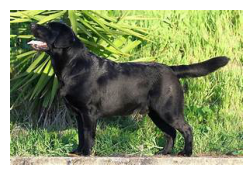

In [59]:
# conda install -c conda-forge opencv
import cv2
import matplotlib.pyplot as plt

image = cv2.cvtColor(cv2.imread(generator.filepaths[3000]), cv2.COLOR_BGR2RGB)

def show_image(image):
    plt.figure(figsize=(3, 3))
    plt.imshow(image)
    plt.axis('off')
    
show_image(image)

##### Data Augmentation, 위치 반전(상하 좌우)

(1, 200, 300, 3)
(200, 300, 3)


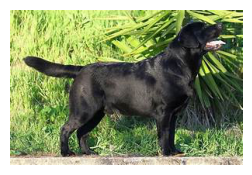

In [60]:
import numpy as np
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Horizontal Filp(좌우 반전)을 적용
# horizontal_flip=True로 적용했지만 반드시 변환되는 것이 아니다!
# 랜덤하게 원본데이터를 유지하거나 반전된 데이터로 사용된다.
data_generator = ImageDataGenerator(horizontal_flip=True)

# ImageDataGenerator는 여러 개의 image를 입력으로 받는다.
# 3차원이 아니라 batch를 포함한 4차원 array를 입력받는다.
image_batch = np.expand_dims(image, axis=0)
print(image_batch.shape)

# ImageDataGenerator 적용, fit()을 한 후 flow()로 image batch를 넣어준다.
data_generator.fit(image_batch)
data_gen_iter = data_generator.flow(image_batch)

# ImageDataGenerator를 동작시키기 위해서는 next() 등으로 iteration을 호출한다.
aug_image_batch = next(data_gen_iter)

# 반환된 이미지 데이터는 다시 3차원 image array로 변환한다.
aug_image = np.squeeze(aug_image_batch)
print(aug_image.shape)

# 반환된 이미지 데이터는 float이기 때문에, 다시 int로 형변환 후 시각화한다.
aug_image = aug_image.astype('int')
show_image(aug_image)

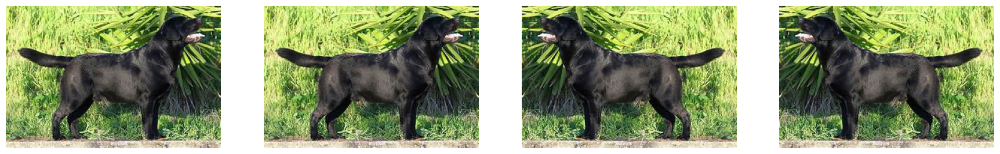

In [61]:
N_IMAGES = 4
fig, axs = plt.subplots(1, N_IMAGES, figsize=(22, 8))

for i in range(N_IMAGES):
    aug_image_batch = next(data_gen_iter)
    aug_image = np.squeeze(aug_image_batch)
    aug_image = aug_image.astype('int')
    axs[i].imshow(aug_image)
    axs[i].axis('off')

In [62]:
def show_aug_image_batch(image, data_genrator, n_images=4, to_int=True):
    image_batch = np.expand_dims(image, axis=0)
    data_generator.fit(image_batch)
    data_gen_iter = data_generator.flow(image_batch)
    
    fig, axs = plt.subplots(1, n_images, figsize=(n_images * 6, 8))
    
    for i in range(n_images):
        aug_image_batch = next(data_gen_iter)
        aug_image = np.squeeze(aug_image_batch)
        if to_int:
            aug_image = aug_image.astype('int')
        
        axs[i].imshow(aug_image)
        axs[i].axis('off')

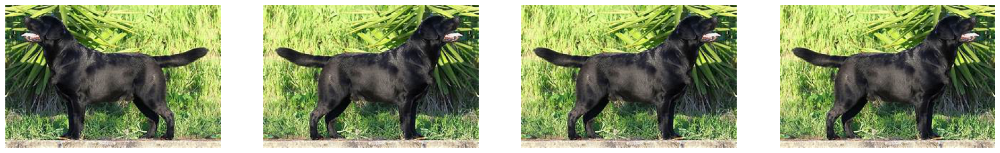

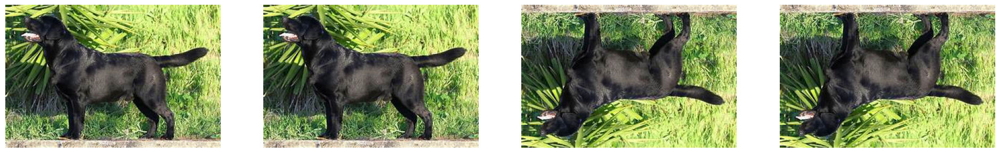

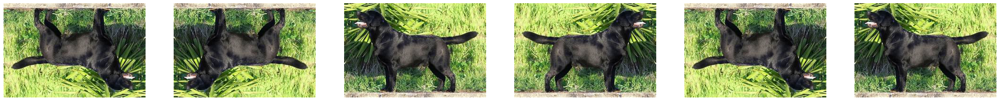

In [63]:
data_genertor = ImageDataGenerator(horizontal_flip=True)
show_aug_image_batch(image, data_generator)

data_generator = ImageDataGenerator(vertical_flip=True)
show_aug_image_batch(image, data_generator)

data_generator = ImageDataGenerator(horizontal_flip=True, vertical_flip=True)
show_aug_image_batch(image, data_gen_iter, n_images=6)

##### Data Augmentation, 회전

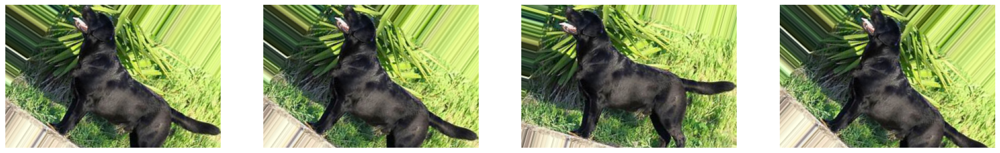

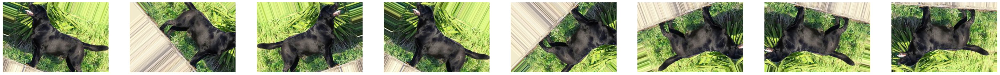

In [64]:
# rotation의 범위를 정한다.
data_generator = ImageDataGenerator(rotation_range=45)
show_aug_image_batch(image, data_generator)

data_generator = ImageDataGenerator(horizontal_flip=True, vertical_flip=True, rotation_range=50)
show_aug_image_batch(image, data_generator, n_images=8)

##### Data Augmentation, 이동

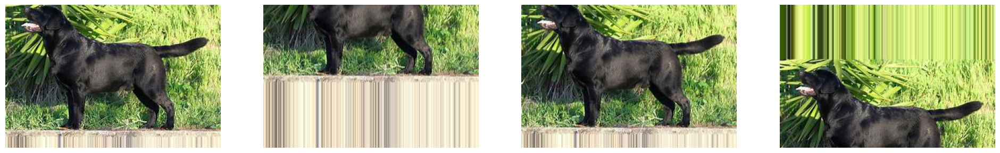

In [65]:
data_generator = ImageDataGenerator(width_shift_range=0.4)
show_aug_image_batch(image, data_generator)

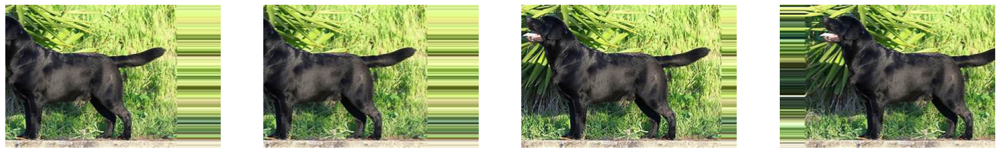

In [66]:
data_generator = ImageDataGenerator(height_shift_range=0.4)
show_aug_image_batch(image, data_generator)

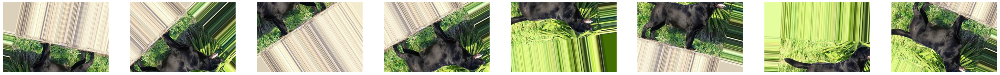

In [67]:
data_generator = ImageDataGenerator(width_shift_range=0.4, height_shift_range=0.4, vertical_flip=True, horizontal_flip=True, rotation_range=50)
show_aug_image_batch(image, data_generator, n_images=8)

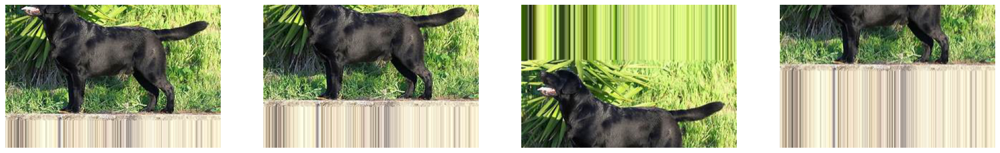

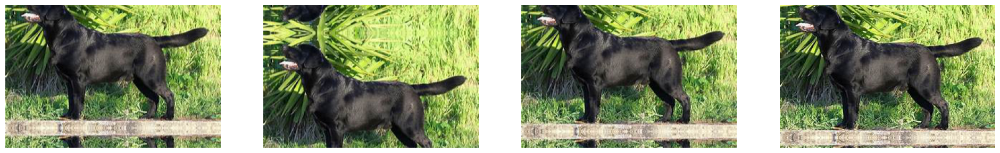

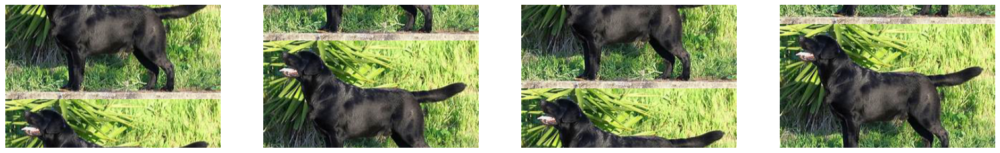

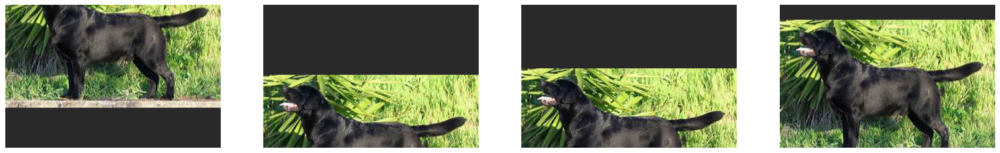

In [68]:
# 빈 공간을 가장 가까운 곳의 픽셀값으로 채움
data_generator = ImageDataGenerator(width_shift_range=0.4, fill_mode='nearest')
show_aug_image_batch(image, data_generator)

# 빈 공간 만큼의 영역을 근처 공간으로 채움
data_generator = ImageDataGenerator(width_shift_range=0.4, fill_mode='reflect')
show_aug_image_batch(image, data_generator)

# 빈 공간을 이동으로 잘려나간 이미지로 채움
data_generator = ImageDataGenerator(width_shift_range=0.4, fill_mode='wrap')
show_aug_image_batch(image, data_generator)

# 특정 픽셀값으로 채우고 이는 cval 값으로 채운다.
data_generator = ImageDataGenerator(width_shift_range=0.4, fill_mode='constant', cval=41)
show_aug_image_batch(image, data_generator)

##### Data Augmentation, 확대, 축소

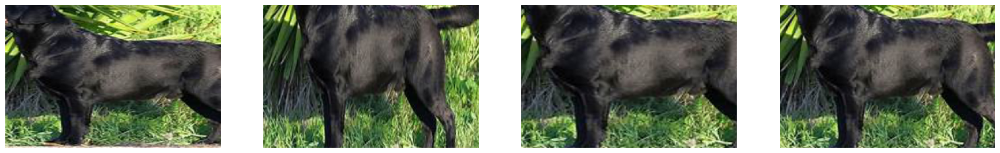

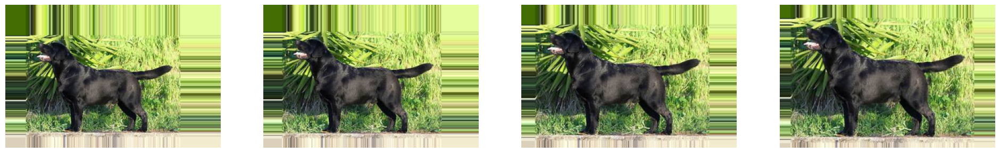

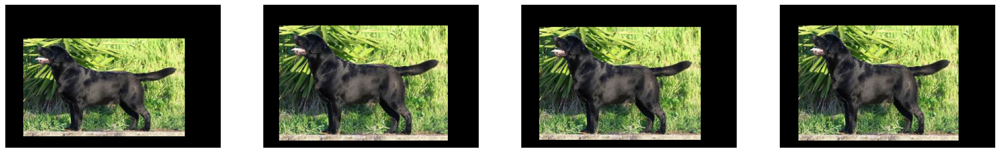

In [69]:
# Zoom In(확대)
data_generator = ImageDataGenerator(zoom_range=[0.5, 0.9])
show_aug_image_batch(image, data_generator)

# Zoom Out(축소)
data_generator = ImageDataGenerator(zoom_range=[1.1, 1.5])
show_aug_image_batch(image, data_generator)

data_generator = ImageDataGenerator(zoom_range=[1.1, 1.5], fill_mode='constant', cval=0)
show_aug_image_batch(image, data_generator)

##### Data Augmentation, 늘리기

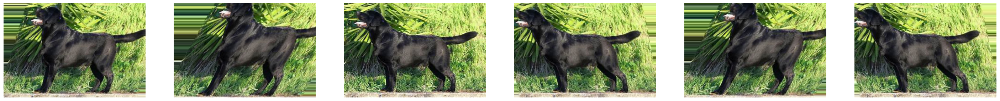

In [70]:
data_generator = ImageDataGenerator(shear_range=45)
show_aug_image_batch(image, data_generator, n_images=6)

##### Data Augmentation, 밝기 조절

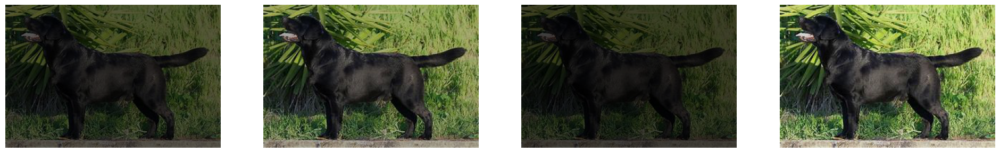

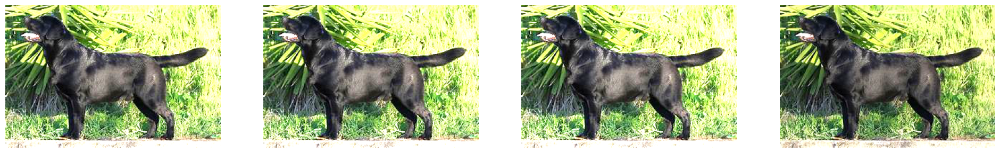

In [71]:
data_generator = ImageDataGenerator(brightness_range=(0.1, 0.9))
show_aug_image_batch(image, data_generator)

data_generator = ImageDataGenerator(brightness_range=(1.0, 2.0))
show_aug_image_batch(image, data_generator)

##### Data Augmentation, 픽셀 값 변경
- 원본 이미지의 RGB pixel 값을 channel_shift_range 범위에 있는 임의의 값으로 변환

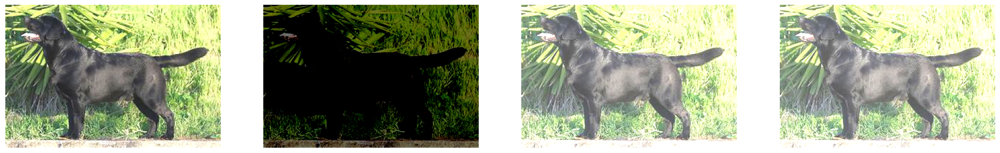

In [72]:
data_generator = ImageDataGenerator(channel_shift_range=150.0)
show_aug_image_batch(image, data_generator)

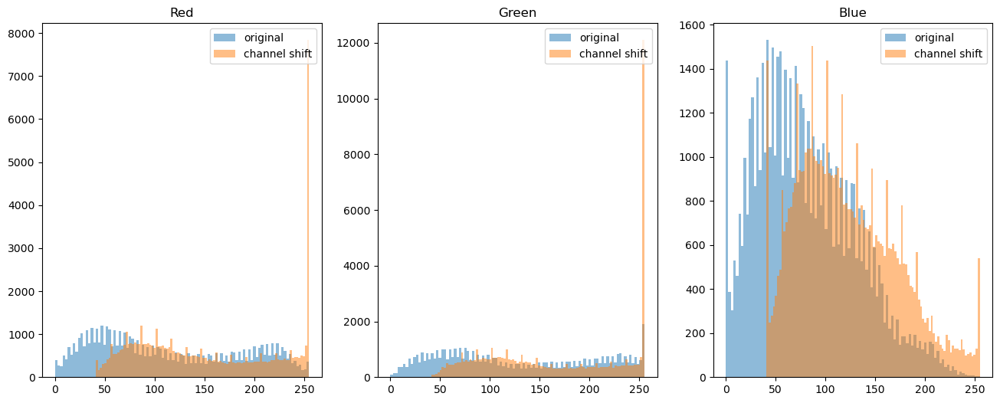

In [73]:
def get_aug_image(image, data_generator):
    image_batch = np.expand_dims(image, axis=0)

    data_generator.fit(image_batch)
    data_gen_iter = data_generator.flow(image_batch)

    aug_image_batch = next(data_gen_iter)

    aug_image = np.squeeze(aug_image_batch)

    aug_image = aug_image
    
    return aug_image

data_generator = ImageDataGenerator(channel_shift_range=150.0)
aug_image = get_aug_image(image, data_generator)


fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(16, 6))

for i in range(3):
    axs[i].hist(image[:, :, i].flatten(), bins=100, alpha=0.5, label="original")
    axs[i].hist(aug_image[:, :, i].flatten(), bins=100, alpha=0.5, label="channel shift")
    axs[i].legend(loc='upper right')
    if i==0:
        title_str = 'Red'
    elif i==1:
        title_str = 'Green'
    else: 
        title_str = 'Blue'
    axs[i].set(title=title_str)

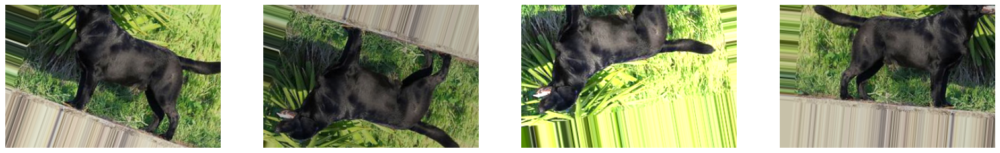

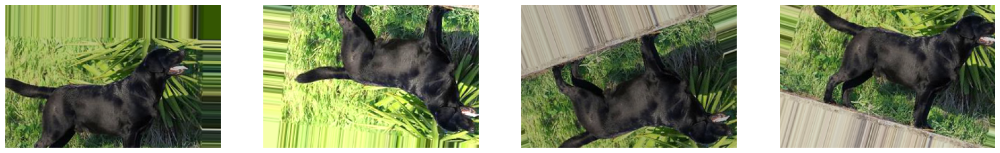

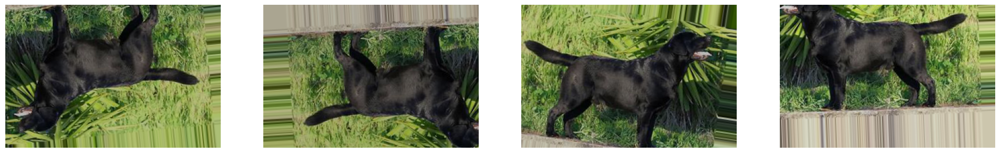

In [75]:
data_generator = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    brightness_range=(0.7, 1.3),
    horizontal_flip=True,
    vertical_flip=True,
#     rescale=1./255
)
show_aug_image_batch(image, data_generator)
show_aug_image_batch(image, data_generator)
show_aug_image_batch(image, data_generator)

#### Albumentations